# Midterm Assignment
## Kiran Rao
My midterm will be around finding fertility data for the five SPAs we are covering in Los Angeles county. I am hoping to use a continuation of my Week 4 assignment work towards my midterm work. 

**Research Question**: What contributes to food security and associated health outcomes at the community level in Los Angeles County? Which SPAs in particular have a lower birth rate and which ones have a higher one?


Before I imported my data, I cleaned it up using Excel and the text-to-columns technique Chris described in the Slack. I am working with three datasets in particular: SPA plotting data, Fertility data, and the census tract. I am going to first work on importing the SPA data to join it to the county-wide data, alongside the fertility data.

## Joining the Data sets

In [41]:
import pandas as pd
import geopandas as gpd
import folium
import matplotlib.pyplot as plt
import contextily as ctx
import esda
from esda.moran import Moran, Moran_Local
import splot
from splot.esda import moran_scatterplot, plot_moran, lisa_cluster,plot_moran_simulation
import libpysal as lps
import matplotlib.pyplot as plt
import plotly.express as px
import folium

**My Data Sources**
For my analysis, I have imported 4 data sources as shown below. The first is fertility/birthing data from the 2022 iteration of the American Community Survey, across census tracts in Los Angeles county. The 2nd is a SPA geojson acting for the shapes for our SPA analysis. I also imported a census data tract for our analysis, and the last file is a census tract file detailing total populations for each of the census tracts we will be looking at, which will be pertinent in calculating our birth rates later on.  

In [5]:
df = pd.read_csv('data/ACSST5Y2022.S1301-Data.csv')

In [6]:
SPA=gpd.read_file('data/Service_Planning_Areas_2022_(view).geojson')

In [7]:
ct_la=gpd.read_file('data/Census_Tracts_2020.geojson')

In [8]:
total_pop=pd.read_csv('data/Total Population.csv')

 ### I am going to attempt to a spatial join on the census tracts and the SPA, and see what the output if I were to map it is. I am using code given to us by Chris around clipping and connecting maps using different boundaries.

In [9]:
result=gpd.sjoin(ct_la,SPA, how='inner', op='within')

/opt/conda/lib/python3.11/site-packages/IPython/core/interactiveshell.py:3493: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


I am then going to print my results, as well as the designated given SPA information.

In [10]:
print(result)

      OBJECTID_left    CT20 LABEL_left   ShapeSTArea  ShapeSTLength  \
0                 1  101110    1011.10  1.229562e+07   15083.854287   
1                 2  101122    1011.22  2.845774e+07   31671.455844   
2                 3  101220    1012.20  7.522093e+06   12698.783810   
3                 4  101221    1012.21  3.812000e+06    9161.710543   
4                 5  101222    1012.22  3.191371e+06    9980.600461   
...             ...     ...        ...           ...            ...   
2389           2390  910720    9107.20  1.803654e+07   18849.973367   
2390           2391  910721    9107.21  2.106451e+07   24064.650352   
2391           2392  910804    9108.04  5.624437e+08  122942.311046   
2399           2400  911100    9111.00  1.747389e+09  225262.057099   
2462           2463  980004    9800.04  3.860575e+08   88187.502509   

                                               geometry  index_right  \
0     POLYGON ((-118.28491 34.25948, -118.28492 34.2...            1   
1  

In [11]:
print(SPA)

   OBJECTID SPA         SPA_NAME ABBV  LABEL  SPA_NUM  SHAPE_Length  \
0         1   1  Antelope Valley  ATV  SPA 1        1      4.471437   
1         2   2     San Fernando  SFV  SPA 2        2      4.267312   
2         3   3      San Gabriel  SGV  SPA 3        3      3.373965   
3         4   4            Metro  MET  SPA 4        4      0.917778   
4         5   5             West    W  SPA 5        5      1.985634   
5         6   6            South    S  SPA 6        6      0.972727   
6         7   7             East    E  SPA 7        7      1.545532   
7         8   8        South Bay  SBA  SPA 8        8      3.944809   

   SHAPE_Area                                           geometry  
0    0.345993  MULTIPOLYGON (((-117.65525 34.39723, -117.6586...  
1    0.243245  MULTIPOLYGON (((-118.76591 34.75362, -118.7657...  
2    0.234567  MULTIPOLYGON (((-117.97230 34.43878, -117.9722...  
3    0.023182  MULTIPOLYGON (((-118.30435 34.15884, -118.3028...  
4    0.048126  MULTIPOLYG

Now that my SPAs are here, I am going to section/clip off the 5 SPAs we are looking at and create a new geodataframe. 

In [12]:
selected_SPAs = SPA[SPA['LABEL'].isin(['SPA 1','SPA 2','SPA 4','SPA 5','SPA 6'])]

In [13]:
new_SPA=gpd.GeoDataFrame(selected_SPAs)

In [14]:
print(new_SPA)

   OBJECTID SPA         SPA_NAME ABBV  LABEL  SPA_NUM  SHAPE_Length  \
0         1   1  Antelope Valley  ATV  SPA 1        1      4.471437   
1         2   2     San Fernando  SFV  SPA 2        2      4.267312   
3         4   4            Metro  MET  SPA 4        4      0.917778   
4         5   5             West    W  SPA 5        5      1.985634   
5         6   6            South    S  SPA 6        6      0.972727   

   SHAPE_Area                                           geometry  
0    0.345993  MULTIPOLYGON (((-117.65525 34.39723, -117.6586...  
1    0.243245  MULTIPOLYGON (((-118.76591 34.75362, -118.7657...  
3    0.023182  MULTIPOLYGON (((-118.30435 34.15884, -118.3028...  
4    0.048126  MULTIPOLYGON (((-118.94470 34.04501, -118.9446...  
5    0.017588  MULTIPOLYGON (((-118.34543 34.03997, -118.3447...  


Next, I will clip the geodataframes by clipping off the census tracts within the 5 SPAs we are analyzing for our report.    

In [15]:
SPAcensus= gpd.clip(ct_la, new_SPA)

In [16]:
print(SPAcensus)

      OBJECTID    CT20    LABEL   ShapeSTArea  ShapeSTLength  \
1037      1038  276606  2766.06  2.334636e+06    7340.205444   
1036      1037  276605  2766.05  2.559688e+06    8205.751141   
1039      1040  276608  2766.08  3.878121e+06    8653.146156   
1045      1046  278102  2781.02  3.540357e+07   34681.313634   
1035      1036  276601  2766.01  2.410894e+07   23283.339996   
...        ...     ...      ...           ...            ...   
2434      2435  920116  9201.16  7.990631e+07   44200.727719   
2437      2438  920120  9201.20  7.914414e+07   45444.306646   
2426      2427  920104  9201.04  1.701460e+09  230726.591287   
2425      2426  920102  9201.02  6.692471e+09  429191.043037   
2345      2346  901209  9012.09  6.428813e+09  568504.396588   

                                               geometry  
1037  POLYGON ((-118.43857 33.95600, -118.43621 33.9...  
1036  POLYGON ((-118.43330 33.95709, -118.43323 33.9...  
1039  POLYGON ((-118.42698 33.95433, -118.42720 33.9...  

To save memory, I'll be "hashtagging" out some of the .info and .type commands just to make my journal a bit shorter. Rest assured I ran these commands to double-check my work!

In [17]:
# SPAcensus.info

In [18]:
SPAcensus.info(verbose=True, show_counts=True)

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 1518 entries, 1037 to 2345
Data columns (total 6 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   OBJECTID       1518 non-null   int64   
 1   CT20           1518 non-null   object  
 2   LABEL          1518 non-null   object  
 3   ShapeSTArea    1518 non-null   float64 
 4   ShapeSTLength  1518 non-null   float64 
 5   geometry       1518 non-null   geometry
dtypes: float64(2), geometry(1), int64(1), object(2)
memory usage: 83.0+ KB


Here, I am just renaming the SPAcensus columns to help with our clip and analysis later on. Also am adding the '06' and '037' values to make them census tract values for plotting later on. 

In [19]:
SPAcensus = SPAcensus[['CT20','geometry']]

In [20]:
SPAcensus.head()

,CT20,geometry
1037,276606,"POLYGON ((-118.43857 33.95600, -118.43621 33.9..."
1036,276605,"POLYGON ((-118.43330 33.95709, -118.43323 33.9..."
1039,276608,"POLYGON ((-118.42698 33.95433, -118.42720 33.9..."
1045,278102,"POLYGON ((-118.45693 33.96210, -118.45675 33.9..."
1035,276601,"POLYGON ((-118.41915 33.95974, -118.41931 33.9..."


In [21]:
SPAcensus['FIPS'] ='06' + '037' + SPAcensus['CT20']

In [22]:
SPAcensus.head()

,CT20,geometry,FIPS
1037,276606,"POLYGON ((-118.43857 33.95600, -118.43621 33.9...",06037276606
1036,276605,"POLYGON ((-118.43330 33.95709, -118.43323 33.9...",06037276605
1039,276608,"POLYGON ((-118.42698 33.95433, -118.42720 33.9...",06037276608
1045,278102,"POLYGON ((-118.45693 33.96210, -118.45675 33.9...",06037278102
1035,276601,"POLYGON ((-118.41915 33.95974, -118.41931 33.9...",06037276601


I've isolated our map to look at the census plots we are looking at for our research project, as shown in the plot below. 

<Axes: >

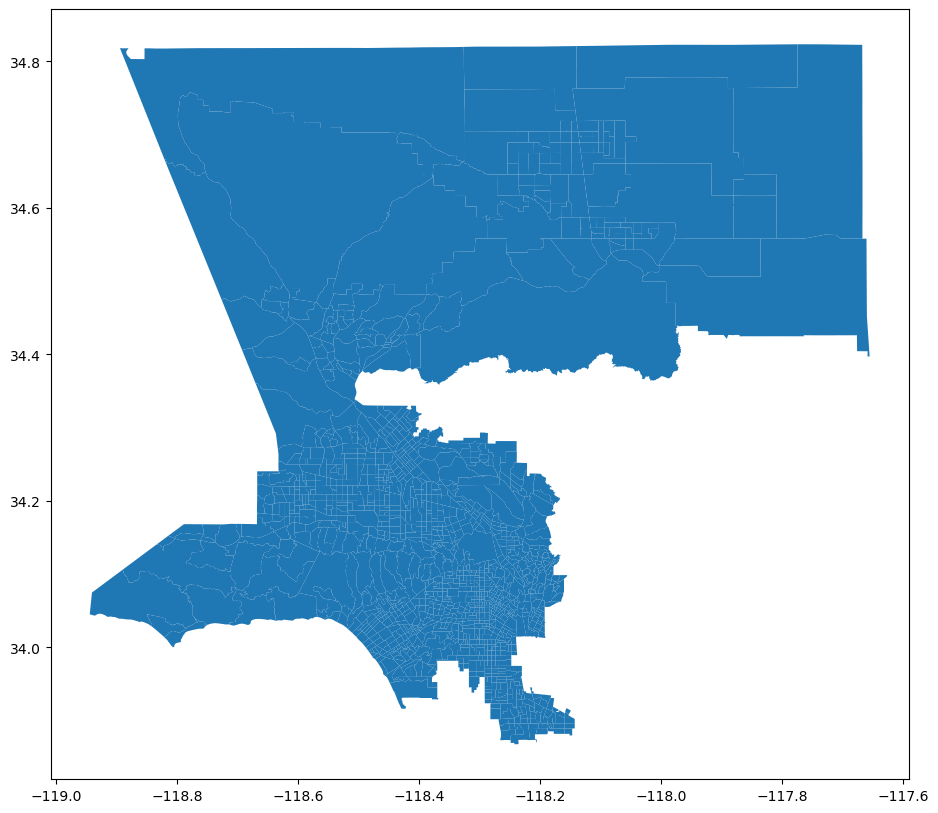

In [23]:
SPAcensus.plot(figsize=(12,10),
                 legend=True, 
                 scheme='NaturalBreaks')

I am now going to rejoin my earlier data from the census tables into my spreadsheet. Below, I just make sure my dataframes look ok.

In [24]:
#df.info

In [25]:
df.head(1)

,GEO_ID,FIPS,NAME,Percentage,Estimate!!Total!!Women 15 to 50 years,Margin of Error!!Total!!Women 15 to 50 years,Estimate!!Total!!Women 15 to 50 years!!15 to 19 years,Margin of Error!!Total!!Women 15 to 50 years!!15 to 19 years,Estimate!!Total!!Women 15 to 50 years!!20 to 34 years,Margin of Error!!Total!!Women 15 to 50 years!!20 to 34 years,...,Estimate!!Percent of women who had a birth in the past 12 months who were unmarried!!PUBLIC ASSISTANCE INCOME IN THE PAST 12 MONTHS!!Women 15 to 50 years,Margin of Error!!Percent of women who had a birth in the past 12 months who were unmarried!!PUBLIC ASSISTANCE INCOME IN THE PAST 12 MONTHS!!Women 15 to 50 years,Estimate!!Percent of women who had a birth in the past 12 months who were unmarried!!PUBLIC ASSISTANCE INCOME IN THE PAST 12 MONTHS!!Women 15 to 50 years!!Received public assistance income,Margin of Error!!Percent of women who had a birth in the past 12 months who were unmarried!!PUBLIC ASSISTANCE INCOME IN THE PAST 12 MONTHS!!Women 15 to 50 years!!Received public assistance income,Estimate!!Percent of women who had a birth in the past 12 months who were unmarried!!PUBLIC ASSISTANCE INCOME IN THE PAST 12 MONTHS!!Women 15 to 50 years!!Did not receive public assistance income,Margin of Error!!Percent of women who had a birth in the past 12 months who were unmarried!!PUBLIC ASSISTANCE INCOME IN THE PAST 12 MONTHS!!Women 15 to 50 years!!Did not receive public assistance income,Estimate!!Percent of women who had a birth in the past 12 months who were unmarried!!PERCENT ALLOCATED!!Marital status,Margin of Error!!Percent of women who had a birth in the past 12 months who were unmarried!!PERCENT ALLOCATED!!Marital status,Estimate!!Percent of women who had a birth in the past 12 months who were unmarried!!PERCENT ALLOCATED!!Fertility,Margin of Error!!Percent of women who had a birth in the past 12 months who were unmarried!!PERCENT ALLOCATED!!Fertility
0,1400000U,6037101110,Census Tract 1011.10; Los Angeles County; Cali...,9.316155,1009,216,46,44,383,107,...,40.4,35.7,100,60.1,12.5,21.6,(X),(X),(X),(X)


In [26]:
#SPAcensus.info(verbose=True, show_counts=True)

In [27]:
SPAcensus.head()

,CT20,geometry,FIPS
1037,276606,"POLYGON ((-118.43857 33.95600, -118.43621 33.9...",06037276606
1036,276605,"POLYGON ((-118.43330 33.95709, -118.43323 33.9...",06037276605
1039,276608,"POLYGON ((-118.42698 33.95433, -118.42720 33.9...",06037276608
1045,278102,"POLYGON ((-118.45693 33.96210, -118.45675 33.9...",06037278102
1035,276601,"POLYGON ((-118.41915 33.95974, -118.41931 33.9...",06037276601


The merge is only going to work when I convert the object to an integer of the SPAcensus above, as its an integer in the fertility data. I'll go ahead and use the 'astype' function to convert the data types. 

In [28]:
SPAcensus['FIPS']=df['FIPS'].astype(int)

In [29]:
SPAcensus.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 1518 entries, 1037 to 2345
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   CT20      1518 non-null   object  
 1   geometry  1518 non-null   geometry
 2   FIPS      1518 non-null   int64   
dtypes: geometry(1), int64(1), object(1)
memory usage: 47.4+ KB


I'll go ahead and merge the plots, as they are now ready to be merged.

In [30]:
SPAcensus_fertility=SPAcensus.merge(df,on="FIPS")

In [31]:
SPAcensus_fertility.head(1)

,CT20,geometry,FIPS,GEO_ID,NAME,Percentage,Estimate!!Total!!Women 15 to 50 years,Margin of Error!!Total!!Women 15 to 50 years,Estimate!!Total!!Women 15 to 50 years!!15 to 19 years,Margin of Error!!Total!!Women 15 to 50 years!!15 to 19 years,...,Estimate!!Percent of women who had a birth in the past 12 months who were unmarried!!PUBLIC ASSISTANCE INCOME IN THE PAST 12 MONTHS!!Women 15 to 50 years,Margin of Error!!Percent of women who had a birth in the past 12 months who were unmarried!!PUBLIC ASSISTANCE INCOME IN THE PAST 12 MONTHS!!Women 15 to 50 years,Estimate!!Percent of women who had a birth in the past 12 months who were unmarried!!PUBLIC ASSISTANCE INCOME IN THE PAST 12 MONTHS!!Women 15 to 50 years!!Received public assistance income,Margin of Error!!Percent of women who had a birth in the past 12 months who were unmarried!!PUBLIC ASSISTANCE INCOME IN THE PAST 12 MONTHS!!Women 15 to 50 years!!Received public assistance income,Estimate!!Percent of women who had a birth in the past 12 months who were unmarried!!PUBLIC ASSISTANCE INCOME IN THE PAST 12 MONTHS!!Women 15 to 50 years!!Did not receive public assistance income,Margin of Error!!Percent of women who had a birth in the past 12 months who were unmarried!!PUBLIC ASSISTANCE INCOME IN THE PAST 12 MONTHS!!Women 15 to 50 years!!Did not receive public assistance income,Estimate!!Percent of women who had a birth in the past 12 months who were unmarried!!PERCENT ALLOCATED!!Marital status,Margin of Error!!Percent of women who had a birth in the past 12 months who were unmarried!!PERCENT ALLOCATED!!Marital status,Estimate!!Percent of women who had a birth in the past 12 months who were unmarried!!PERCENT ALLOCATED!!Fertility,Margin of Error!!Percent of women who had a birth in the past 12 months who were unmarried!!PERCENT ALLOCATED!!Fertility
0,276606,"POLYGON ((-118.43857 33.95600, -118.43621 33.9...",6037276606,1400000U,Census Tract 2766.06; Los Angeles County; Cali...,1.897321,896,188,8,12,...,0,79.8,-,**,0,79.8,(X),(X),(X),(X)


Now since that worked, let's clean up the data by pulling the columns that we are interested in. I am going to pull a small subset of data as there are over 300 columns of data to sort, and I will only be needing the larger numbers.

In [32]:
#SPAcensus_fertility.columns

In [33]:
columns_to_keep =['geometry',
                  'FIPS',
                  'GEO_ID',
                  'NAME',
                  'Estimate!!Total!!Women 15 to 50 years',
                  'Estimate!!Number!!Women with births in the past 12 months!!Women 15 to 50 years',
                  'Estimate!!Number!!Women with births in the past 12 months!!PERCENT ALLOCATED!!Fertility']
                  

In [34]:
SPAcensus_fertility2= SPAcensus_fertility[columns_to_keep]

In [35]:
SPAcensus_fertility2.columns

Index(['geometry', 'FIPS', 'GEO_ID', 'NAME',
       'Estimate!!Total!!Women 15 to 50 years',
       'Estimate!!Number!!Women with births in the past 12 months!!Women 15 to 50 years',
       'Estimate!!Number!!Women with births in the past 12 months!!PERCENT ALLOCATED!!Fertility'],
      dtype='object')

I am going to plot the overall numbers of women with births in the past 12 months. In an ideal world, I would be able to use the number of births, but that information is not readily available by census tract. As a result, for this section, I am going to use the number of women with births in the past year figure and extrapolate to mean the amount of births. While this may be slightly off, as it doesn't account for multiple-children in one birthing (such as twins or triplets), I am going to make this assumption to create a birth rate we can use in the project. Below, I've ploted in on our SPACensus tract map.

In [54]:
minx, miny, maxx, maxy = SPAcensus_fertility2.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13240863.775860488
4011055.574756902
-13097322.290505065
4139894.7354539772


In [55]:
SPAcensus_fertility2 = SPAcensus_fertility2.to_crs(epsg=3857)


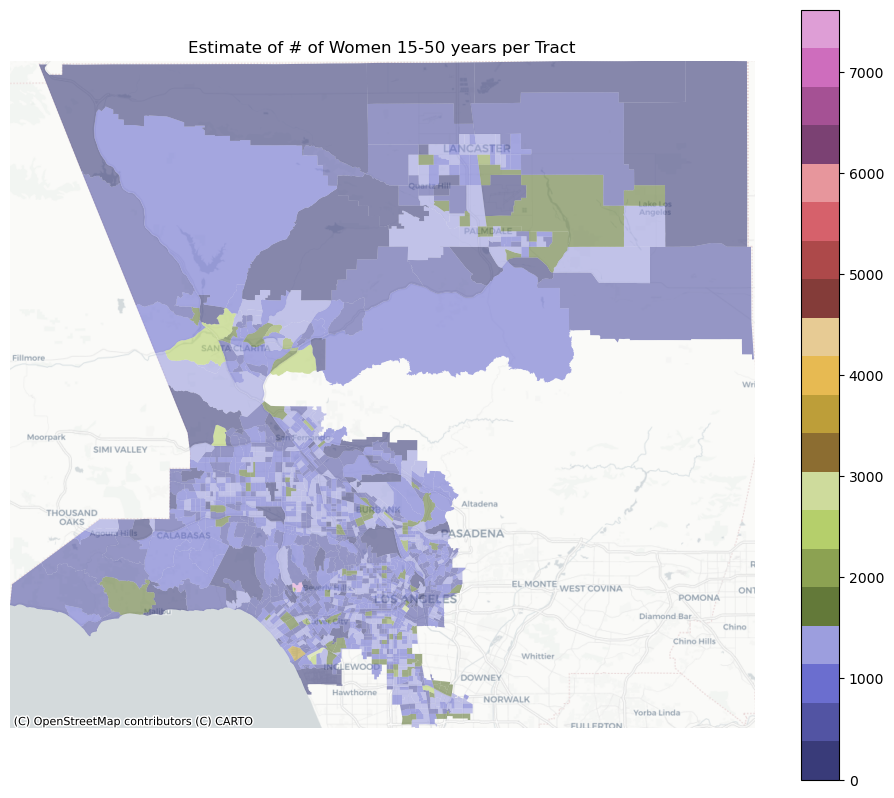

In [60]:
fig, ax = plt.subplots(figsize=(12,10))


SPAcensus_fertility2.plot(ax=ax,
                 column='Estimate!!Total!!Women 15 to 50 years',
                 cmap='tab20b',
                 alpha=0.6,
                 legend=True)

ax.set_xlim(minx-5, maxx+5) 
ax.set_ylim(miny-5, maxy+5)
            
plt.title("Estimate of # of Women 15-50 years per Tract")

ax.axis('off')

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron) 

The above shows a consistently low amount of births throughout the map. The highest # of births is located in SPA 2, with the rest of the SPAs showing pretty low numbers, aside from parts of SPA 5 & 6, with pocked of pinkish, orange. Let's also calculate the average number of births per tract. 

In [95]:
import numpy
numpy.mean(SPAcensus_fertility2['Estimate!!Number!!Women with births in the past 12 months!!Women 15 to 50 years'])

41.65151515151515

Looks like the average number of births is about 41 births, but there are plenty of tracts that also seem to have near zero values. I am going to calculate how many tracts have zero births below, using the code from class.

In [102]:
SPAcensus_fertility2_none=SPAcensus_fertility2[SPAcensus_fertility2['Estimate!!Number!!Women with births in the past 12 months!!Women 15 to 50 years']==0]
print('There are ' + str(len(SPAcensus_fertility2_none)) + ' census tracts with no births in them')

There are 198 census tracts with no births in them


## Mapping the intial births per tract data.

Moving into this next part, I am going to use folium to create an interactive chart showing the births by tract. This will help create a visualization of where the populations are that have higher versus lower birth rates. Beyond that, I am also going to incorporate code that allows for the use of a tooltip which, when hovering above said census tract, will display the census tract number alongside the number of births in said tract.

In [44]:
import folium
m = folium.Map(location=[34.2,-118.2], 
               zoom_start = 9,
               tiles='CartoDB positron', 
               attribution='CartoDB')

In [103]:
cp=folium.Choropleth(
                  geo_data=SPAcensus_fertility2,
                  data=SPAcensus_fertility2,         
                  key_on='feature.properties.FIPS',
                  columns=['FIPS', 'Estimate!!Number!!Women with births in the past 12 months!!Women 15 to 50 years'], 
                  fill_color='BuPu',
                  line_weight=0.1, 
                  fill_opacity=0.8,
                  line_opacity=0.2, 
                  legend_name='Women with Births in the past 12 months, 15-50 years old').add_to(m)    
m

In [104]:
SPAcensus_fertility2_indexed = SPAcensus_fertility2.set_index('FIPS')
#SPAcensus_fertility2_indexed

The below is code I sourced regarding how to incorporate GeoJsontooltip into my maps. I will link my source here: https://python-visualization.github.io/folium/latest/user_guide/geojson/geojson_popup_and_tooltip.html. 

In [47]:
for row in cp.geojson.data['features']:
    try:
        row['properties']['Women Who Have Given Birth']=str(SPAcensus_fertility2.loc[['FIPS'],'Estimate!!Number!!Women with births in the past 12 months!!Women 15 to 50 years'])
    except KeyError:
        row['properties']['Birth Rate'] = 'None'
        
folium.GeoJsonTooltip(['FIPS','Estimate!!Number!!Women with births in the past 12 months!!Women 15 to 50 years'],aliases=['FIPS:','Women Who Have Given Birth']).add_to(cp.geojson)

In [48]:
folium.LayerControl().add_to(m)

m

Looking at the above data, I am able to scroll into each SPA and look more into detail about the tracts that compromise it. While we are not currently doing a geographical analysis (taking into account how surrounding geographical & manmade features may affect food insecurity and therefore health outcomes), it is still pertinent to see where these tracts are and where they lie in accordance to the food insecurity measures we have determined as well. The dark purple census tract located above Santa Clarita is the most present tract on the map, and is also one of the biggest, geographically. While census tracts have been determined to carry a similar population weight, it makes sense for us to calculate an analysis taking into account the actual population of these tracts, and from there create a birth rate that can give us an idea of where these places may be impacted, if at all. 

Birth rates are a key indicator of fertility and can help determine if there is a health outcome from the event of food insecurity. I am going to go ahead and pull in the total population data to understand the data we are working with, and do another merge with our SPA census data to start our analysis. I'll start by changing the names of my columns. 

In [50]:
total_pop.head()

,GEO_ID,Unnamed: 1,NAME,Total Population
0,1400000U,6037101110,"Census Tract 1011.10, Los Angeles County, Cali...",4926
1,1400000U,6037101122,"Census Tract 1011.22, Los Angeles County, Cali...",3728
2,1400000U,6037101220,"Census Tract 1012.20, Los Angeles County, Cali...",3344
3,1400000U,6037101221,"Census Tract 1012.21, Los Angeles County, Cali...",3444
4,1400000U,6037101222,"Census Tract 1012.22, Los Angeles County, Cali...",2808


In [51]:
total_pop.columns=['GEO_ID','FIPS','NAME','Total Population']

In [52]:
total_pop.head()

,GEO_ID,FIPS,NAME,Total Population
0,1400000U,6037101110,"Census Tract 1011.10, Los Angeles County, Cali...",4926
1,1400000U,6037101122,"Census Tract 1011.22, Los Angeles County, Cali...",3728
2,1400000U,6037101220,"Census Tract 1012.20, Los Angeles County, Cali...",3344
3,1400000U,6037101221,"Census Tract 1012.21, Los Angeles County, Cali...",3444
4,1400000U,6037101222,"Census Tract 1012.22, Los Angeles County, Cali...",2808


Below, I am using the merge function again to create a new data set with all the variables we need to analyze appropiately. 

In [53]:
totalpop_fertility=SPAcensus_fertility2.merge(total_pop,on="FIPS")

In [105]:
totalpop_fertility.head(1)

,geometry,FIPS,GEO_ID_x,NAME_x,Estimate!!Total!!Women 15 to 50 years,Estimate!!Number!!Women with births in the past 12 months!!Women 15 to 50 years,Estimate!!Number!!Women with births in the past 12 months!!PERCENT ALLOCATED!!Fertility,GEO_ID_y,NAME_y,Total Population,Birth Rate
0,"POLYGON ((-118.43857 33.95600, -118.43621 33.9...",6037276606,1400000U,Census Tract 2766.06; Los Angeles County; Cali...,896,17,(X),1400000U,"Census Tract 2766.06, Los Angeles County, Cali...",3353,0.00507


In [65]:
totalpop_fertility.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 1518 entries, 0 to 1517
Data columns (total 11 columns):
 #   Column                                                                                   Non-Null Count  Dtype   
---  ------                                                                                   --------------  -----   
 0   geometry                                                                                 1518 non-null   geometry
 1   FIPS                                                                                     1518 non-null   int64   
 2   GEO_ID_x                                                                                 1518 non-null   object  
 3   NAME_x                                                                                   1518 non-null   object  
 4   Estimate!!Total!!Women 15 to 50 years                                                    1518 non-null   int64   
 5   Estimate!!Number!!Women with births in the past

Now that I've created the new data set, I am going to create a new column/variable of "Birth Rate". I am using the definition of Birth Rate pulled from the CDC, as to mean the amount of births, divided by the total population. Again the amount of births here will be represented by the woman giving birth. I will then map it accordingly. CDC source: https://www.cdc.gov/nchs/hus/sources-definitions/rate.htm#:~:text=Birth%20rate%3A%20Calculated%20by%20dividing,population%20as%20of%20April%201.

In [55]:
totalpop_fertility['Birth Rate']=totalpop_fertility['Estimate!!Number!!Women with births in the past 12 months!!Women 15 to 50 years']/totalpop_fertility['Total Population']

Text(0.5, 1.0, 'Birth Rate (by tract)')

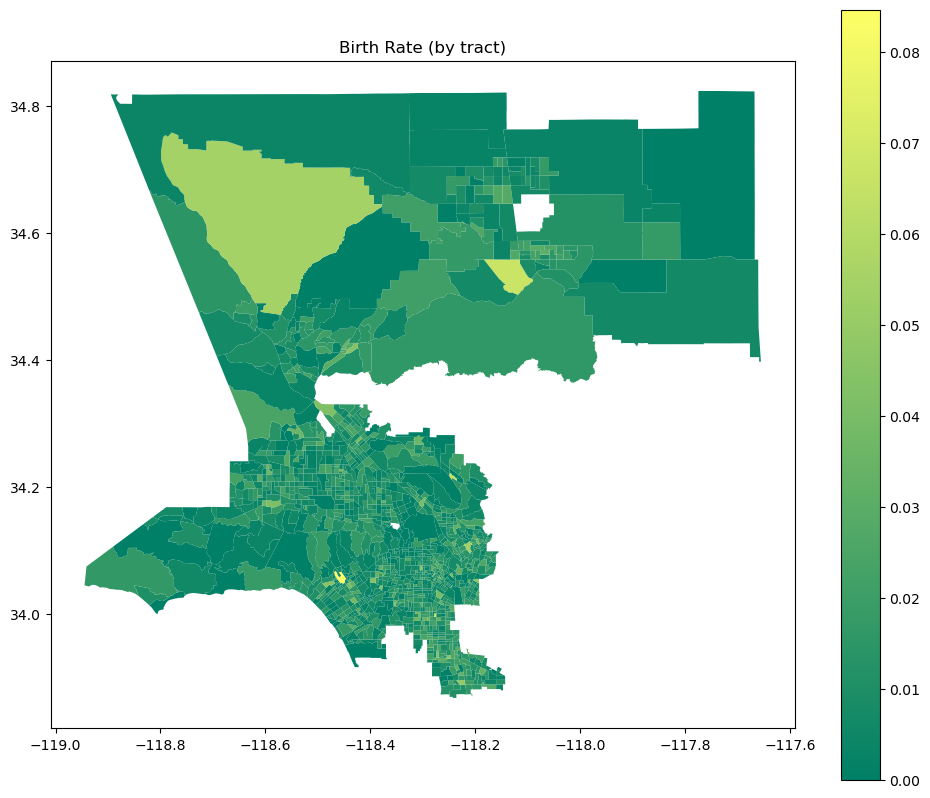

In [56]:
totalpop_fertility.plot(figsize=(12,10),
                        column='Birth Rate',
                        cmap='summer',
                        legend=True)

plt.title("Birth Rate (by tract)")

Taking into account the total population, it looks like the the same tract we were discussing earlier are still relevant! While they do not have the highest birth rate, the light green indicates a higher birth rate. Again, most of the population looks to be on the lower end of the color spectrum, designating a lower birth rate. We can also derive the average of the birth rates across the tracts and see what we are working with. For comparison, the U.S. birth rate is about .012 to .011 over the last couple of years. Source: https://www.axios.com/2023/10/04/birth-rate-fertility-rate-decline-data-statistics-graph-2022

In [57]:
import numpy
numpy.mean(totalpop_fertility['Birth Rate'])

0.01072711358134992

Now, I am going to sort the data by the highest and lowest birth rates. From here, I will plot them on maps and use our SPA boundaries as an overlap to see where the common patterns of low and high birth rates are. I am going to plot the top 1% of birth rate by tracts as well as all the tracts that had a 0% birth rate and compare accordingly. 

In [58]:
TPF_sorted = totalpop_fertility.sort_values(by='Birth Rate',ascending = False)

In [59]:
TPF_sorted2 = totalpop_fertility.sort_values(by='Birth Rate',ascending = True)

In [108]:
TPF_sorted[['FIPS','Birth Rate']].head(5)

,FIPS,Birth Rate
54,6037980017,0.084732
172,6037231901,0.068588
1153,6037910213,0.066926
1221,6037300601,0.065095
1516,6037920102,0.054741


In [109]:
TPF_sorted2[['FIPS','Birth Rate']].head(5)

,FIPS,Birth Rate
474,6037700200,0.0
194,6037224702,0.0
196,6037224701,0.0
198,6037600802,0.0
1022,6037203100,0.0


In [106]:
TPF_sorted['Birth Rate'].value_counts(5)

Birth Rate
0.000000    0.127561
0.010989    0.001983
0.008016    0.001322
0.026415    0.001322
0.004000    0.001322
              ...   
0.014028    0.000661
0.014045    0.000661
0.014050    0.000661
0.014054    0.000661
0.010309    0.000661
Name: proportion, Length: 1309, dtype: float64

<Axes: title={'center': 'Top 1% Tract-wide Birth Rates'}>

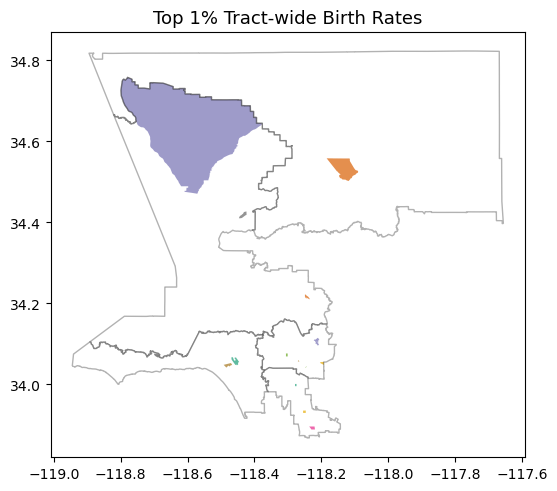

In [107]:

fig2 = plt.figure(constrained_layout=True)
submap = fig2.add_gridspec(1,1)
map_TPF = fig2.add_subplot(submap[:, 0])
map_TPF.set_title('Top 1% Tract-wide Birth Rates',fontsize=13)

TPF_sorted.head(15).plot(ax=map_TPF,figsize=(8,6),cmap='Dark2')


new_SPA.plot(ax = map_TPF,
               alpha=0.3,
             zorder = 5,
             color='white',
            edgecolor='black')

<Axes: title={'center': '0% Tract-wide Birth Rates'}>

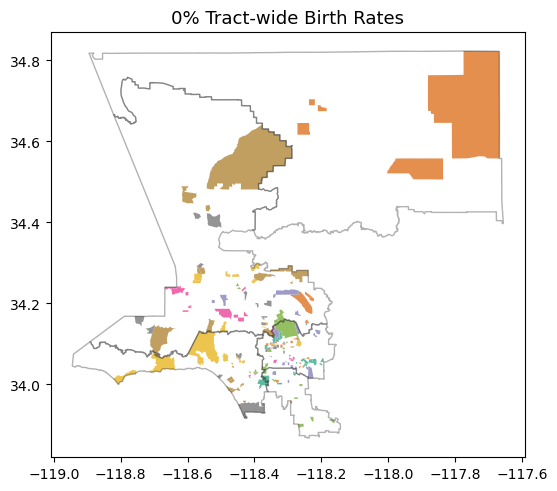

In [74]:
fig3 = plt.figure(constrained_layout=True)
submap = fig3.add_gridspec(1,1)
map_TPF2 = fig3.add_subplot(submap[:, 0])
map_TPF2.set_title('0% Tract-wide Birth Rates',fontsize=13)

TPF_sorted2.head(193).plot(ax=map_TPF2,figsize=(8,6),cmap='Dark2')


new_SPA.plot(ax = map_TPF2,
               alpha=0.3,
             zorder = 5,
             color='white',
            edgecolor='black')



The top 1% of census-wide birth rates map has tracts spread through the SPAs, so it isn't entirely helpful to us. However, the ones with the 0% tract-wide birth rates are showing up significantly in the lower/southern part of our map. This bodes well for us to understand what it means for those specific communities, which are also denser, to have birth rates of 0. Interestingly enough, it is also important to recognize there may be data missing from the more rural communities in the top two SPAs, that we are not accounting for. As the birth data is pulled from a survey, it may be possible that those SPAs simply don't have an accurate measure of their birth rates as a result of lack of information.

Below, I am going to plot some of our birth rates to see common patterns in the data, such as frequency and distribution of different rates. 

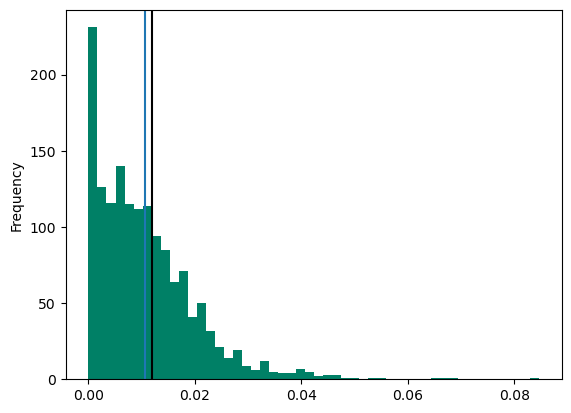

In [113]:
TPF_sorted['Birth Rate'].plot.hist(bins=50,cmap='summer')
plt.axvline(.012, color='k')
plt.axvline(0.0107)

The highest frequency of birth rates is 0, with a downward trend towards a higher birth rate. The blue line represents the average of the dataset, while the black line represents the national average. 

<Axes: >

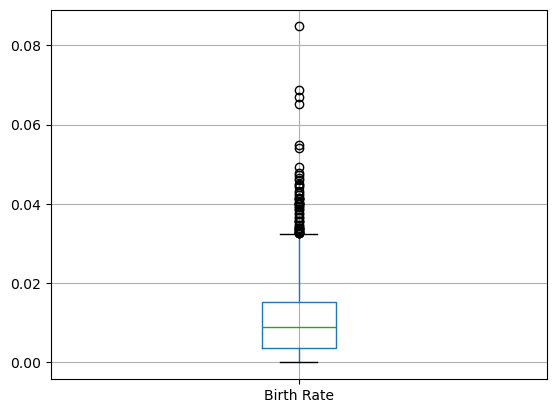

In [87]:
TPF_sorted.boxplot(column=['Birth Rate'])

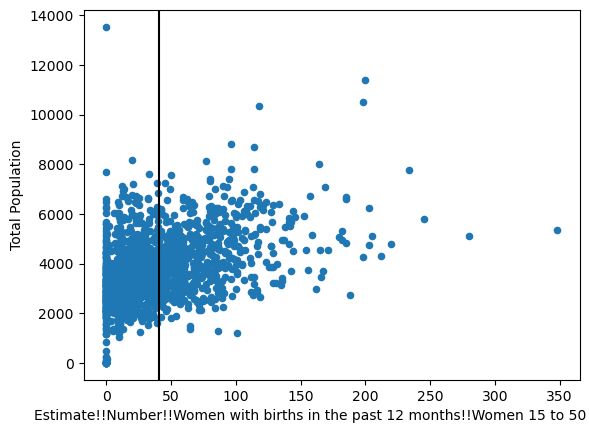

In [115]:
TPF_sorted.plot.scatter(y='Total Population',x='Estimate!!Number!!Women with births in the past 12 months!!Women 15 to 50 years')
plt.axvline(41,color='k')

The scatter plot shows a gradual upward trend, showing more women having babies in tracts where there are higher populations, as expected. There is still a cluster towards the left side, showing the lower birth rate as expected. The Black line depicts the average of the dataset, around 41 births per census tract. Looking at our data, there is some clear differentiation between SPAs, but it may also take sense to take into consideration the amount of reproductive age women in each census tract, as that plays a large factor into our calculations as well. We can create a Fertility Rate, again pulled from the CDC. While they define it as the amount of livebirths per 1000 women of reproductive age, we are simply going to use the variable of women who gave birth within a year and divide by the total amount of women in the census tract. From there, I'll go ahead and map it as well. 

In [120]:
totalpop_fertility['Fertility Rate']=totalpop_fertility['Estimate!!Number!!Women with births in the past 12 months!!Women 15 to 50 years']/totalpop_fertility['Estimate!!Total!!Women 15 to 50 years']

Text(0.5, 1.0, 'Fertility Rate (by tract)')

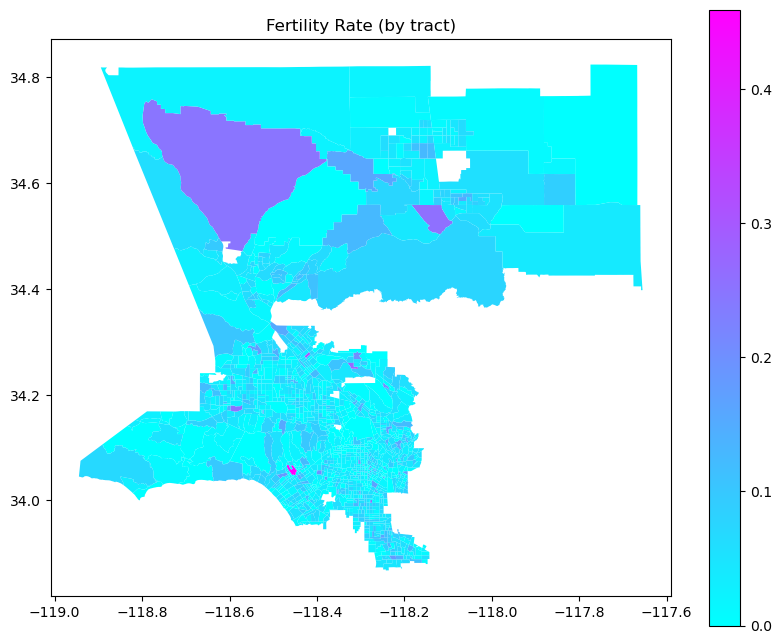

In [123]:
totalpop_fertility.plot(figsize=(10,8),
                        column='Fertility Rate',
                        cmap='cool',
                        legend=True)

plt.title("Fertility Rate (by tract)")

In [124]:
numpy.mean(totalpop_fertility['Fertility Rate'])

0.04356177677400118

The data's mean is displayed above, alongside the plot. Unsurprisingly, not much seems to have changed in regard to comparing birth rates to fertility rates. The fertility rate, as we've calculated it, is quite significantly lower than the national average, which is about .123. This can simply be due to the change in our methodology for accounting for children. This figure can still prove helpful-- let's compare it in a scatter plot against our birth rate data to see if and how there is a correlation between the two. In my hypothesis, I believe there will be a strong, positive correlation - birth and fertility rates will roughly correspond to one another. 

<Axes: xlabel='Birth Rate', ylabel='Fertility Rate'>

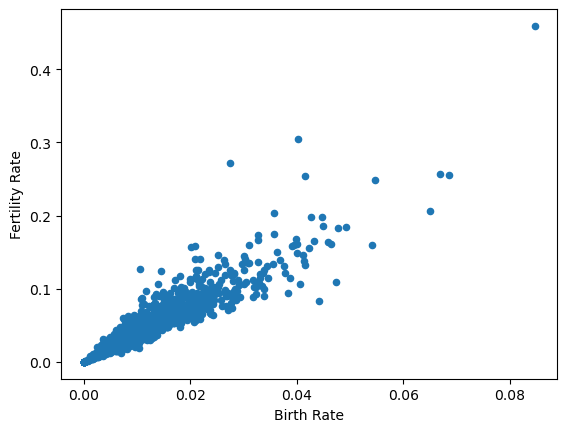

In [129]:
totalpop_fertility.plot.scatter(x='Birth Rate',y='Fertility Rate')

There is a strong association but not a perfect correlation. There's a difference in the valuation given, obviously. However, there is still a positive regression between the two values, despite some outliers. For our data, this means that we can continue to isolate SPAs 4 and 6 as options for the lower end of our fertility/birth outcomes scale, and SPAs 2 and 5 as examples of higher fertility outcomes. I will cross reference these results with what my team members received for their specific tracts and we will then have the two SPAs we'd like to focus on. 

**Division of Labor**

*Ashley*: Analysed SNAP usage and SNAP Acceptance Count across 5 SPAs in LA County from 2017-2023. 

*Maya*: Analyzed race breakup and median household income across 5 SPAs in LA County. 

*Kiran*: Created code to trim down census tracts to only look at the 5 SPAs we are looking at, which served as base code for the other’s analysis; Analyzed birth rates (amount of women giving birth per census tract and creating a percentage of women per tract who gave birth) using American Community Survey Data from 2022 amongst the 5 chosen SPAs in Los Angeles County. 

*Savannah*: Analyzed low birth weight proportions out of all live births among 5 SPAs in LA County in 2021(?) using CalEnviroScreen Data.

*Xander*: Childhood food access visualization + analysis of 5 SPAs in LA county in 2015 + 2019
